In [56]:
import numpy as np
import sympy as sp
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
sp.init_printing()

### Nieskończona studnia potencjału

$$\frac{d^2\psi}{dx^2}=-k^2\psi$$

In [2]:
sx = sp.Symbol('x', real = True)
sk = sp.Symbol('k', real = True, positive = True)
sa = sp.Symbol('a', real = True, positive = True)
sA = sp.Symbol('A', real = True, positive = True)
sn = sp.Symbol('n', integer = True, positive = True)
spsi = sp.Function('psi')
sx, sk, spsi(sx), sa

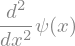

In [3]:
spsi(sx).diff(sx, 2)

In [4]:
-sk**2*spsi(sx)

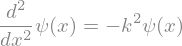

In [5]:
eq = sp.Eq(spsi(sx).diff(sx, 2), -sk**2*spsi(sx))
eq

In [6]:
sp.dsolve(eq, spsi(sx))

$$\psi(0)=0$$

In [7]:
sp.dsolve(eq, spsi(sx), ics = {spsi(0): 0})

In [8]:
sp.dsolve(eq, spsi(sx), ics = {spsi(0): 0, spsi(sa): 0})

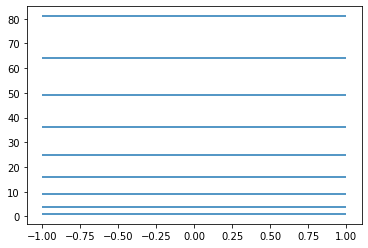

In [9]:
energy = [n**2 for n in range(1,10)]
plt.hlines(energy, -1, 1)

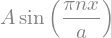

In [10]:
spsi = sA * sp.sin(sn * sp.pi * sx / sa)
spsi

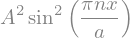

In [11]:
sp.Abs(spsi)**2

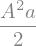

In [12]:
sp.integrate(sp.Abs(spsi)**2, (sx, 0, sa))

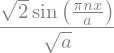

In [14]:
spsi = spsi.subs(sA, sp.sqrt(2/sa))
spsi

In [16]:
sp.integrate(sx * spsi * spsi, (sx, 0, sa)).simplify()

In [17]:
def psi(x, n, a = 1):
    return np.sqrt(2 / a) * np.sin(n * np.pi * x / a)

In [22]:
n = 1
quad(lambda x: psi(x, n) * psi(x, n), 0, 1)

In [26]:
n = 10
quad(lambda x: x * psi(x, n) * psi(x, n), 0, 1)

In [27]:
def E(n, h = 1, a = 1, m = 1):
    return n * n * h * h * np.pi * np.pi / (2 * m * a * a)

In [32]:
def Psi(x, t, n, h = 1):
    return psi(x, n = n) * np.exp(-1j * E(n, h = h) * t / h)

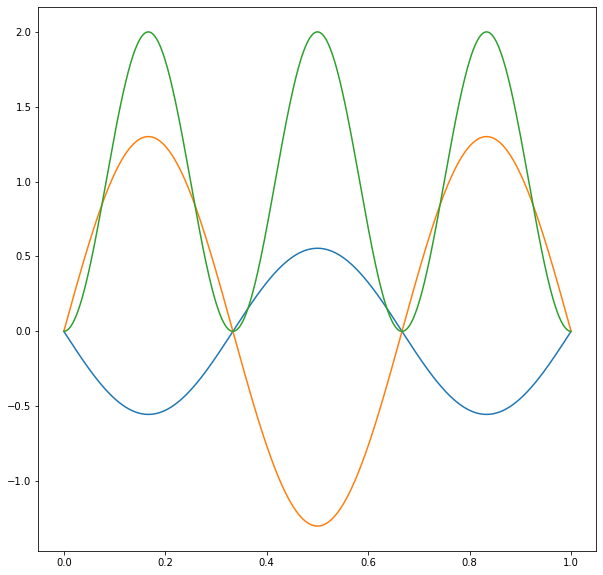

In [46]:
n = 3
t = 10
xs = np.linspace(0, 1, 1000)
plt.figure(figsize = (10, 10))
plt.plot(xs, Psi(xs, t = t, n = n).real)
plt.plot(xs, Psi(xs, t = t, n = n).imag)
plt.plot(xs, np.abs(Psi(xs, t = t, n = n))**2)

In [62]:
n = 3
xs = np.linspace(0, 1, 1000)

fig = plt.figure(figsize = (10, 10))
ax = plt.axes(xlim = (0, 1), ylim = (-3, 3))
line1, = ax.plot([], [])
line2, = ax.plot([], [])
line3, = ax.plot([], [])

plt.close()

dt = 0.005

T = 2 * np.pi / E(n)

def frame(i):
   line1.set_data(xs, Psi(xs, t = i * dt, n = n).real)
   line2.set_data(xs, Psi(xs, t = i * dt, n = n).imag)
   line3.set_data(xs, np.abs(Psi(xs, t = i * dt, n = n))**2)
   
   return line1, line2, line3

anim = FuncAnimation(fig, frame, frames = int(T / dt), blit = True, interval = 30)
HTML(anim.to_jshtml())
   

In [65]:
na = 2
nb = 3

xs = np.linspace(0, 1, 1000)

fig = plt.figure(figsize = (10, 10))
ax = plt.axes(xlim = (0, 1), ylim = (-3, 3))
line1, = ax.plot([], [])
line2, = ax.plot([], [])
line3, = ax.plot([], [])

plt.close()

dt = 0.005

def frame(i):
   superpozycja = (Psi(xs, t = i * dt, n = na) + Psi(xs, t = i * dt, n = nb)) / np.sqrt(2)
   line1.set_data(xs, superpozycja.real)
   line2.set_data(xs, superpozycja.imag)
   line3.set_data(xs, np.abs(superpozycja)**2)
   
   return line1, line2, line3

anim = FuncAnimation(fig, frame, frames = 500, blit = True, interval = 30)
HTML(anim.to_jshtml())
   

Animation size has reached 20989097 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [67]:
def PsiSum(x, t, cn):
    ys = np.zeros_like(x, dtype = np.complex128)
    norm = np.sqrt(np.sum(np.abs(np.array([*cn.values()]))**2))
    for n, v in cn.items():
        ys += v * Psi(x, t, n) / norm
    return ys

In [68]:
cn = {1:1, 2:1, 3:1, 4:1}

fig = plt.figure()
ax = plt.axes(xlim = (0, 1), ylim = (0, 5))

line1, = plt.plot([], [])
line2, = plt.plot([], [])
line3, = plt.plot([], [])

plt.close()

dt = 0.005

def animation_frame(i):
    #line1.set_data(xs, PsiSum(xs, i * dt, cn).real)
    #line2.set_data(xs, PsiSum(xs, i * dt, cn).imag)
    line3.set_data(xs, np.abs(PsiSum(xs, i * dt, cn))**2)

    return line1, line2, line3

anim = FuncAnimation(fig, animation_frame, frames = 500, blit = True, interval = 30)
HTML(anim.to_jshtml())